In [2]:
#Enabling memory growth for GPU
import tensorflow as tf
from tensorflow.compat.v1 import InteractiveSession
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [8]:
from IPython.core.display_functions import display
import pickle
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from dataclasses import dataclass
import IPython
import pandas as pd
import numpy as np
import keras_tuner as kt
from tensorflow.keras import regularizers
from tensorflow.keras.layers import LeakyReLU
import gc
from tensorflow.keras.callbacks import Callback
import warnings

## EDA

In [30]:
# Import
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
stores = pd.read_csv("stores.csv")
#sub = pd.read_csv("../input/store-sales-time-series-forecasting/sample_submission.csv")
transactions = pd.read_csv("transactions.csv").sort_values(["store_nbr", "date"])


# Datetime
train["date"] = pd.to_datetime(train.date)
test["date"] = pd.to_datetime(test.date)
transactions["date"] = pd.to_datetime(transactions.date)

# Data types
train.onpromotion = train.onpromotion.astype("float16")
train.sales = train.sales.astype("float32")
stores.cluster = stores.cluster.astype("int8")

train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0.0
1,1,2013-01-01,1,BABY CARE,0.0,0.0
2,2,2013-01-01,1,BEAUTY,0.0,0.0
3,3,2013-01-01,1,BEVERAGES,0.0,0.0
4,4,2013-01-01,1,BOOKS,0.0,0.0


### Transactions

In [6]:
transactions.head(10)

,date,store_nbr,transactions
1,2013-01-02,1,2111
47,2013-01-03,1,1833
93,2013-01-04,1,1863
139,2013-01-05,1,1509
185,2013-01-06,1,520
231,2013-01-07,1,1807
277,2013-01-08,1,1869
323,2013-01-09,1,1910
369,2013-01-10,1,1679
415,2013-01-11,1,1813


In [9]:
temp = pd.merge(train.groupby(["date", "store_nbr"]).sales.sum().reset_index(), transactions, how = "left")
print("Spearman Correlation between Total Sales and Transactions: {:,.4f}".format(temp.corr("spearman").sales.loc["transactions"]))
px.line(transactions.sort_values(["store_nbr", "date"]), x='date', y='transactions', color='store_nbr',title = "Transactions" )

Spearman Correlation between Total Sales and Transactions: 0.8175


In [10]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month
px.box(a, x="year", y="transactions" , color = "month", title = "Transactions")

In [11]:
a = transactions.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(a, x='date', y='transactions', color='year',title = "Monthly Average Transactions" )

In [12]:
px.scatter(temp, x = "transactions", y = "sales", trendline = "ols", trendline_color_override = "red")

In [13]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["dayofweek"] = a.date.dt.dayofweek+1
a = a.groupby(["year", "dayofweek"]).transactions.mean().reset_index()
px.line(a, x="dayofweek", y="transactions" , color = "year", title = "Transactions")

### Oil

In [15]:
# Import
oil = pd.read_csv("oil.csv")
oil["date"] = pd.to_datetime(oil.date)
# Resample
oil = oil.set_index("date").dcoilwtico.resample("D").sum().reset_index()
# Interpolate
oil["dcoilwtico"] = np.where(oil["dcoilwtico"] == 0, np.nan, oil["dcoilwtico"])
oil["dcoilwtico_interpolated"] =oil.dcoilwtico.interpolate()
# Plot
p = oil.melt(id_vars=['date']+list(oil.keys()[5:]), var_name='Legend')
px.line(p.sort_values(["Legend", "date"], ascending = [False, True]), x='date', y='value', color='Legend',title = "Daily Oil Price" )

Correlation with Daily Oil Prices
sales          -0.303237
transactions    0.040105
Name: dcoilwtico_interpolated, dtype: float64 



C:\Users\13486\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\plotting\_matplotlib\core.py:1114: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



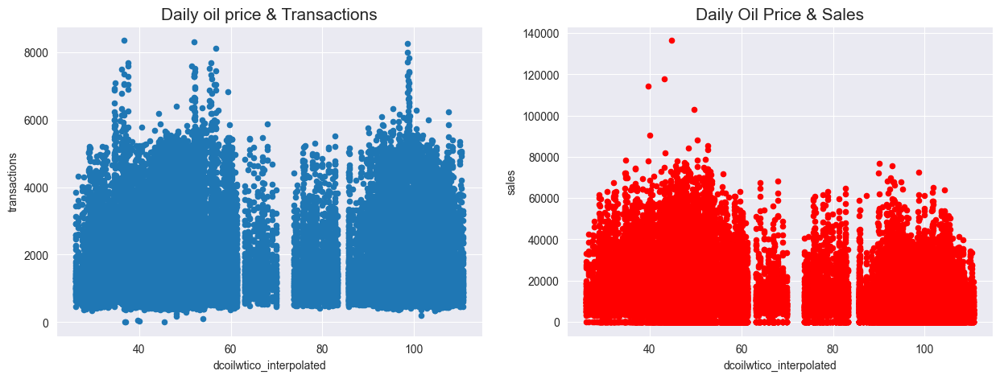

In [16]:
temp = pd.merge(temp, oil, how = "left")
print("Correlation with Daily Oil Prices")
print(temp.drop(["store_nbr", "dcoilwtico"], axis = 1).corr("spearman").dcoilwtico_interpolated.loc[["sales", "transactions"]], "\n")


fig, axes = plt.subplots(1, 2, figsize = (15,5))
temp.plot.scatter(x = "dcoilwtico_interpolated", y = "transactions", ax=axes[0])
temp.plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1], color = "r")
axes[0].set_title('Daily oil price & Transactions', fontsize = 15)
axes[1].set_title('Daily Oil Price & Sales', fontsize = 15);

### Sales
#### We aim to predict store sales for various product families, necessitating a detailed examination of the sales data to uncover elements like seasonality, trends, and anomalies, as well as to compare similarities and differences with other time series data. While analyzing the correlation matrix, it appears that the majority of the stores display similar characteristics. However, a few stores, specifically numbers 20, 21, 22, and 52, seem to exhibit distinct patterns compared to the others.

C:\Users\13486\AppData\Local\Temp\ipykernel_26756\2316645891.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\13486\AppData\Local\Temp\ipykernel_26756\2316645891.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



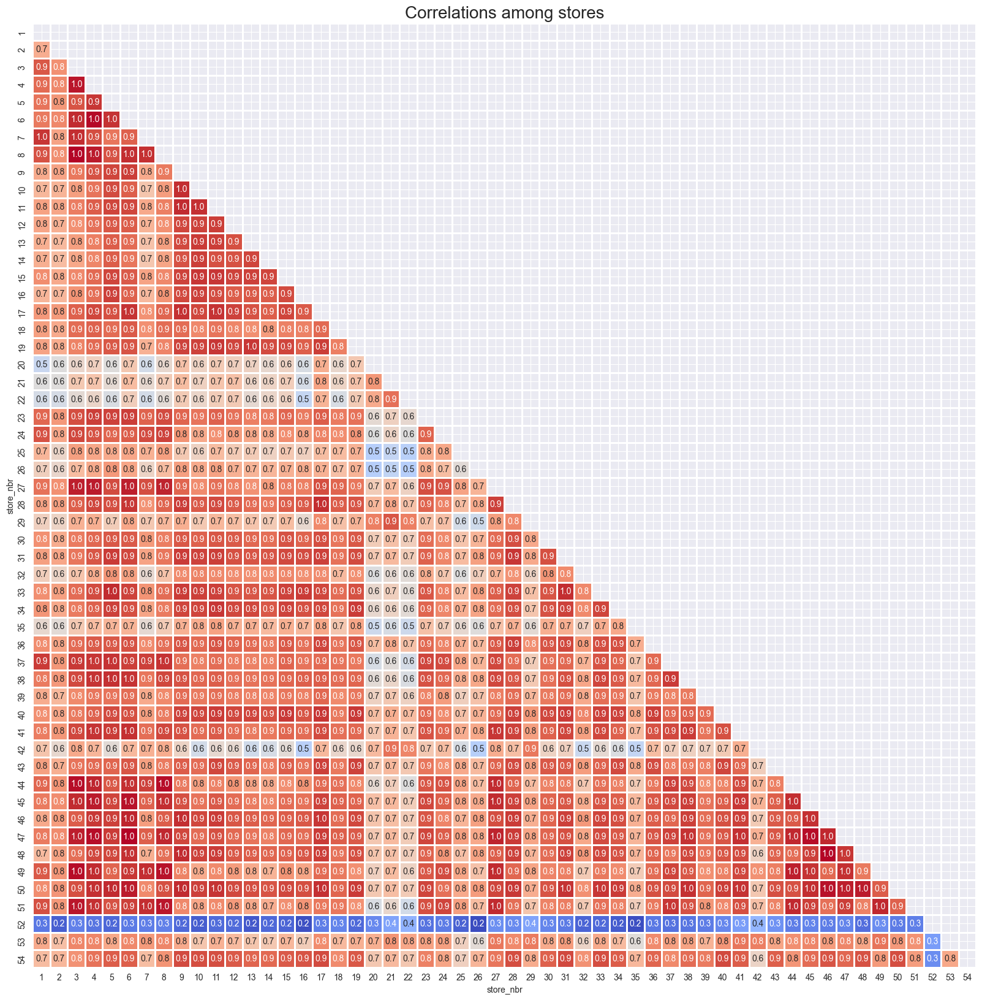

In [17]:
a = train[["store_nbr", "sales"]]
a["ind"] = 1
a["ind"] = a.groupby("store_nbr").ind.cumsum().values
a = pd.pivot(a, index = "ind", columns = "store_nbr", values = "sales").corr()
mask = np.triu(a.corr())
plt.figure(figsize=(20, 20))
sns.heatmap(a,
        annot=True,
        fmt='.1f',
        cmap='coolwarm',
        square=True,
        mask=mask,
        linewidths=1,
        cbar=False)
plt.title("Correlations among stores",fontsize = 20)
plt.show()

In [18]:
a = train.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
px.line(a, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

## LSTM-CNN Combined Model

In [3]:
# for reproducibility
seed0=1337
np.random.seed(seed0)
tf.keras.utils.set_random_seed(seed0)
tf.config.experimental.enable_op_determinism()
tf.random.set_seed(seed0)
pd.set_option('display.max_colwidth', None)
pd.options.display.float_format = '{:.2f}'.format
warnings.filterwarnings('ignore')

In [4]:
train=pd.read_csv("train.csv")
test=pd.read_csv("test.csv")
holiday_events=pd.read_csv("holidays_events.csv")
oil=pd.read_csv("oil.csv")
stores=pd.read_csv("stores.csv")
transactions=pd.read_csv("transactions.csv")

In [5]:
# converting date to datetime data type
train["date"] = pd.to_datetime(train.date)
test["date"] = pd.to_datetime(test.date)
holiday_events["date"] = pd.to_datetime(holiday_events.date)
oil["date"] = pd.to_datetime(oil.date)
transactions["date"] = pd.to_datetime(transactions.date)

In [6]:
#merging datasets

def joins(df,holiday_events,oil,stores):
    print(df.shape)
    holiday_events=holiday_events.drop_duplicates(subset=['date'], keep='last')
    df_holiday=pd.merge(df,holiday_events,how="left",on='date', validate="many_to_one")
    print(f"Shape after merging with holiday {df_holiday.shape}")
    df_holiday_oil=pd.merge(df_holiday,oil,how="left",on='date')
    print(f"Shape after merging with holiday + oil {df_holiday_oil.shape}")
    df_holiday_oil_stores=pd.merge(df_holiday_oil,stores,how="left",on="store_nbr",suffixes=("holiday","stores"))
    print(f"Shape after merging with holiday + oil + stores {df_holiday_oil_stores.shape}")
    return df_holiday_oil_stores

train_merged=joins(train,holiday_events,oil,stores)
# display(train_merged.head(1),train_merged.tail(1))
test_merged=joins(test,holiday_events,oil,stores)
# display(test_merged.head(1),test_merged.tail(1))



# extracting time features for train dataset
train_merged['day_of_week'] = train_merged['date'].dt.day_of_week
train_merged['day_of_week'] = train_merged['day_of_week']+1
train_merged['month'] = train_merged['date'].dt.month
train_merged['year'] = train_merged['date'].dt.year

# extracting time features for test dataset
test_merged['day_of_week'] = test_merged['date'].dt.day_of_week
test_merged['day_of_week'] = test_merged['day_of_week']+1
test_merged['month'] = test_merged['date'].dt.month
test_merged['year'] = test_merged['date'].dt.year

(3000888, 6)
Shape after merging with holiday (3000888, 11)
Shape after merging with holiday + oil (3000888, 12)
Shape after merging with holiday + oil + stores (3000888, 16)
(28512, 5)
Shape after merging with holiday (28512, 10)
Shape after merging with holiday + oil (28512, 11)
Shape after merging with holiday + oil + stores (28512, 15)


In [7]:
# printing basic properties of features
display(train_merged.describe(include="all").T,train_merged.head() )

C:\Users\13486\AppData\Local\Temp\ipykernel_5008\656187664.py:2: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  display(train_merged.describe(include="all").T,train_merged.head() )


,count,unique,top,freq,first,last,mean,std,min,25%,50%,75%,max
id,3000888.0,NaN,NaN,NaN,NaT,NaT,1500443.5,866281.891642,0.0,750221.75,1500443.5,2250665.25,3000887.0
date,3000888,1684,2013-01-01 00:00:00,1782,2013-01-01,2017-08-15,NaN,NaN,NaN,NaN,NaN,NaN,NaN
store_nbr,3000888.0,NaN,NaN,NaN,NaT,NaT,27.5,15.585787,1.0,14.0,27.5,41.0,54.0
family,3000888,33,AUTOMOTIVE,90936,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sales,3000888.0,NaN,NaN,NaN,NaT,NaT,357.775749,1101.997721,0.0,0.0,11.0,195.84725,124717.0
onpromotion,3000888.0,NaN,NaN,NaN,NaT,NaT,2.60277,12.218882,0.0,0.0,0.0,0.0,741.0
typeholiday,449064,6,Holiday,263736,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
locale,449064,3,National,249480,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
locale_name,449064,22,Ecuador,249480,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
description,449064,97,Carnaval,17820,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,id,date,store_nbr,family,sales,onpromotion,typeholiday,locale,locale_name,description,transferred,dcoilwtico,city,state,typestores,cluster,day_of_week,month,year
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0,Holiday,National,Ecuador,Primer dia del ano,False,NaN,Quito,Pichincha,D,13,2,1,2013
1,1,2013-01-01,1,BABY CARE,0.0,0,Holiday,National,Ecuador,Primer dia del ano,False,NaN,Quito,Pichincha,D,13,2,1,2013
2,2,2013-01-01,1,BEAUTY,0.0,0,Holiday,National,Ecuador,Primer dia del ano,False,NaN,Quito,Pichincha,D,13,2,1,2013
3,3,2013-01-01,1,BEVERAGES,0.0,0,Holiday,National,Ecuador,Primer dia del ano,False,NaN,Quito,Pichincha,D,13,2,1,2013
4,4,2013-01-01,1,BOOKS,0.0,0,Holiday,National,Ecuador,Primer dia del ano,False,NaN,Quito,Pichincha,D,13,2,1,2013


In [8]:
###  Changing Transfer Day to Normal Day ###
def transfer_holiday_fix(df):
    df["typeholiday"]=np.where(df["transferred"]==True,'NDay',df["typeholiday"])
    df["typeholiday"]=np.where(df["typeholiday"]=='Work Day','NDay',df["typeholiday"])
    df["typeholiday"]=df["typeholiday"].fillna("NDay")
    return df

train_merged=transfer_holiday_fix(train_merged)
test_merged=transfer_holiday_fix(test_merged)
# checking new structure of holiday type column
display(train_merged["typeholiday"].value_counts(dropna=False))
display(test_merged["typeholiday"].value_counts(dropna=False))


NDay          2576772
Holiday        247698
Event           98010
Additional      58806
Transfer        16038
Bridge           3564
Name: typeholiday, dtype: int64

NDay       26730
Holiday     1782
Name: typeholiday, dtype: int64

In [9]:
display(train_merged.columns)

Index(['id', 'date', 'store_nbr', 'family', 'sales', 'onpromotion',
       'typeholiday', 'locale', 'locale_name', 'description', 'transferred',
       'dcoilwtico', 'city', 'state', 'typestores', 'cluster', 'day_of_week',
       'month', 'year'],
      dtype='object')

In [10]:
#### LOCAL TEST, ELSE Part is not needed#######################

#### SELECT USEFUL COLUMN(FEATURES) ####
def select_relevant(df):
    print(f"shape before removing columns {df.shape}")
    features=["date","family","sales","onpromotion","typeholiday","dcoilwtico","city",#"state",
              "typestores","cluster","day_of_week","month","year"]
    if "sales" in df.columns:
        df= df[features]
    else:
        features.remove("sales")
        df= df[features]
    print(f"Shape after removing columns {df.shape}")
    return df

train_merged=select_relevant(train_merged)
test_merged=select_relevant(test_merged)
display(test_merged.columns)

shape before removing columns (3000888, 19)
Shape after removing columns (3000888, 12)
shape before removing columns (28512, 18)
Shape after removing columns (28512, 11)


Index(['date', 'family', 'onpromotion', 'typeholiday', 'dcoilwtico', 'city',
       'typestores', 'cluster', 'day_of_week', 'month', 'year'],
      dtype='object')

In [11]:
### FIX MISSING data in Oil Price ####

# replace all 0 price by using both the previous and next non-missing values
def interpolate_oil(df):
    df["dcoilwtico"]=np.where(df["dcoilwtico"] ==0, np.nan, df["dcoilwtico"])
    df.dcoilwtico.interpolate(limit_direction='both',inplace=True)
    return df


train_merged=interpolate_oil(train_merged)
test_merged=interpolate_oil(test_merged)
display(f"Number of nan in train dataset oil price after interpolation {train_merged['dcoilwtico'].isna().sum()}")
display(f"Number of nan in test dataset oil price after interpolation {test_merged['dcoilwtico'].isna().sum()}")

'Number of nan in train dataset oil price after interpolation 0'

'Number of nan in test dataset oil price after interpolation 0'

In [12]:
# converting category columns to str type
category_columns=['family', 'typeholiday', 'city', 'typestores', 'cluster']
for column in category_columns:
    train_merged[column] = train_merged[column].astype('str')
    test_merged[column] = test_merged[column].astype('str')

# converting extracted time features to float
time_columns=["month","day_of_week","year"]
for column in time_columns:
    train_merged[column] = train_merged[column].astype('float')
    test_merged[column] = test_merged[column].astype('float')

# checking conditions of training and test datasets
display(train_merged.head(3))
display(train_merged.tail(3))
display(train_merged.describe(include="all").T)

,date,family,sales,onpromotion,typeholiday,dcoilwtico,city,typestores,cluster,day_of_week,month,year
0,2013-01-01,AUTOMOTIVE,0.0,0,Holiday,93.14,Quito,D,13,2.0,1.0,2013.0
1,2013-01-01,BABY CARE,0.0,0,Holiday,93.14,Quito,D,13,2.0,1.0,2013.0
2,2013-01-01,BEAUTY,0.0,0,Holiday,93.14,Quito,D,13,2.0,1.0,2013.0


,date,family,sales,onpromotion,typeholiday,dcoilwtico,city,typestores,cluster,day_of_week,month,year
3000885,2017-08-15,PRODUCE,2419.729,148,Holiday,47.57,Quito,B,6,2.0,8.0,2017.0
3000886,2017-08-15,SCHOOL AND OFFICE SUPPLIES,121.000,8,Holiday,47.57,Quito,B,6,2.0,8.0,2017.0
3000887,2017-08-15,SEAFOOD,16.000,0,Holiday,47.57,Quito,B,6,2.0,8.0,2017.0


C:\Users\13486\AppData\Local\Temp\ipykernel_5008\1835320036.py:16: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  display(train_merged.describe(include="all").T)


,count,unique,top,freq,first,last,mean,std,min,25%,50%,75%,max
date,3000888,1684,2013-01-01 00:00:00,1782,2013-01-01,2017-08-15,NaN,NaN,NaN,NaN,NaN,NaN,NaN
family,3000888,33,AUTOMOTIVE,90936,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sales,3000888.0,NaN,NaN,NaN,NaT,NaT,357.775749,1101.997721,0.0,0.0,11.0,195.84725,124717.0
onpromotion,3000888.0,NaN,NaN,NaN,NaT,NaT,2.60277,12.218882,0.0,0.0,0.0,0.0,741.0
typeholiday,3000888,6,NDay,2576772,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dcoilwtico,3000888.0,NaN,NaN,NaN,NaT,NaT,67.89353,25.685176,26.19,46.37,53.303305,95.79115,110.62
city,3000888,22,Quito,1000296,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
typestores,3000888,5,D,1000296,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cluster,3000888,17,3,389004,NaT,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN
day_of_week,3000888.0,NaN,NaN,NaN,NaT,NaT,3.997031,2.00074,1.0,2.0,4.0,6.0,7.0


In [13]:
# # saving them in to a csv
# train_merged.to_csv('train_merged.csv', index=False)
# test_merged.to_csv('test_merged.csv', index=False)

#### Predictiong by using LSTM with CNN

In [14]:
#main modules for preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, Normalizer, MinMaxScaler, PolynomialFeatures
from sklearn.preprocessing import FunctionTransformer, KBinsDiscretizer
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_iterative_imputer

from sklearn.preprocessing import TargetEncoder

#main modules for designing ML pipeliens
from mlxtend.feature_selection import ColumnSelector
from sklearn.pipeline import Pipeline, make_pipeline, FeatureUnion
from sklearn.compose import ColumnTransformer
from mlxtend.feature_selection import ExhaustiveFeatureSelector as EFS

#main module for evaluation
from sklearn.metrics import mean_squared_log_error, mean_absolute_error, mean_squared_error,r2_score

In [15]:
# helper function to evaluate model
def calcMetrics(testActualVal, predictions):
    #regression evaluation measures
    data={"RMSLE":[mean_squared_log_error(testActualVal, predictions)**0.5],
         "MAE":[mean_absolute_error(testActualVal, predictions)],
         "RMSE":[mean_squared_error(testActualVal, predictions)**0.5],
         "R2":[r2_score(testActualVal, predictions)]}
    metric_df=pd.DataFrame(data)
    return metric_df

In [16]:
# making a copy of dataset
dnn_df=train_merged.copy()
df_dnn_test_check=test_merged.copy()

# removing the 2nd copy to free memory
del train_merged
del test_merged
dnn_df["cat_gen"]=dnn_df["family"]+dnn_df["city"]+dnn_df["cluster"]  # incorporate 3 important features
display(f'store_nbr nunique: {train["store_nbr"].nunique()}, family nunique: {dnn_df["family"].nunique()}, city nunique: {dnn_df["city"].nunique()}, cluster nunique: {dnn_df["cluster"].nunique()}, cat_gen nunique: {dnn_df["cat_gen"].nunique()}')

'store_nbr nunique: 54, family nunique: 33, city nunique: 22, cluster nunique: 17, cat_gen nunique: 1353'

In [17]:
#col_names_dnn=['cat_gen', 'family','typeholiday', 'city','typestores', 'cluster','dcoilwtico', 'date','day_of_week', 'month', 'year']
col_names_dnn=['cat_gen', 'date']
dnn_df_x=dnn_df[col_names_dnn]
dnn_df_y=dnn_df["sales"]

In [18]:
# sub pipeline to apply said transformation on derived feature
# using target encoder to convert category variables into numerical variales, than classify by bins
category_feat_dnn=Pipeline(steps=[("target_encode",TargetEncoder(target_type="continuous")),
                                 ("combiner",KBinsDiscretizer(n_bins=130, strategy='kmeans',
                                  subsample=None, random_state=seed0,encode='ordinal'))
                                 ])

# Apply Pipeline to previous features col and keep the rest part
preprocess_pipe_dnn = Pipeline(steps=[
    ('encoder', ColumnTransformer(
                    transformers=[
                        ("category_trans",category_feat_dnn,["cat_gen"])
                                ],
                                remainder="passthrough", verbose_feature_names_out=True
                            )),
    ("pandarizer2", FunctionTransformer(lambda x: pd.DataFrame(x, columns =  col_names_dnn)))
                            ],verbose = True)

# converting date to string to avoid it getting transformed to float
dnn_df_x = dnn_df_x.astype({'date':'string'})
preprocess_pipe_dnn.fit(dnn_df_x,dnn_df_y)



[Pipeline] ........... (step 1 of 2) Processing encoder, total=   6.6s
[Pipeline] ....... (step 2 of 2) Processing pandarizer2, total=   0.0s


Pipeline(steps=[('encoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('category_trans',
                                                  Pipeline(steps=[('target_encode',
                                                                   TargetEncoder(target_type='continuous')),
                                                                  ('combiner',
                                                                   KBinsDiscretizer(encode='ordinal',
                                                                                    n_bins=130,
                                                                                    random_state=1337,
                                                                                    strategy='kmeans',
                                                                                    subsample=None))]),
                                                  ['cat_gen'])])),
                ('pandarizer2',
                 FunctionTransformer(func=<function <lambda> at 0x0000023DAA7E7370>))],
         verbose=True)

In [19]:
# checking if the ordering of feature names are correct
display(preprocess_pipe_dnn['encoder'].feature_names_in_)
display(preprocess_pipe_dnn['encoder'].get_feature_names_out())

dnn_df_x=preprocess_pipe_dnn.transform(dnn_df_x)
display(dnn_df_x.head(2),dnn_df_x.tail(2),dnn_df_x.shape )

array(['cat_gen', 'date'], dtype=object)

array(['category_trans__cat_gen', 'remainder__date'], dtype=object)

,cat_gen,date
0,0.0,2013-01-01
1,0.0,2013-01-01


,cat_gen,date
3000886,0.0,2017-08-15
3000887,0.0,2017-08-15


(3000888, 2)

In [20]:
dnn_training_features= ['cat_gen', 'date']
dnn_df_x=dnn_df_x[dnn_training_features]
#concatenating features and 'sales' value datasets
dnn_df_processed=pd.concat([dnn_df_x,dnn_df_y], axis=1)
# converting date to datetime dtype
dnn_df_processed["date"] = pd.to_datetime(dnn_df_processed.date)
dnn_df_processed["sales"] = dnn_df_processed["sales"].astype(np.float32)
dnn_df_processed.head(2)

,cat_gen,date,sales
0,0.0,2013-01-01,0.0
1,0.0,2013-01-01,0.0


In [21]:
# removing to free memory
del dnn_df_x
del dnn_df_y

In [22]:
# applying the same transformations to test dataset
df_dnn_test_check["cat_gen"]=df_dnn_test_check["family"]+df_dnn_test_check["city"]+df_dnn_test_check["cluster"]
df_dnn_test_check = df_dnn_test_check.astype({'date':'string'})
df_dnn_test_check=preprocess_pipe_dnn.transform(df_dnn_test_check)
df_dnn_test_check=df_dnn_test_check[dnn_training_features]
df_dnn_test_check["date"] = pd.to_datetime(df_dnn_test_check.date)
# checking if train have any class that test don't have, if so I will remove it
display(f"test: {df_dnn_test_check['cat_gen'].nunique()} number of class in the derived category")
display(f"train: {dnn_df_processed['cat_gen'].nunique()} number of class in the derived category")

'test: 98 number of class in the derived category'

'train: 98 number of class in the derived category'

In [23]:
# I will use the 95 day from end of train dataset time series for validation
Test_sample_size=95
SPLIT_DATE=pd.to_datetime("2017-08-15")-pd.to_timedelta((Test_sample_size), unit='d')
Train_sample_size =365*4+1
Training_interval=pd.to_timedelta((Train_sample_size), unit='d')
train_data_begin_date=SPLIT_DATE-Training_interval
display(f"train_data_begin_date: {train_data_begin_date}")
dnn_df_processed=dnn_df_processed.loc[dnn_df_processed["date"]>=train_data_begin_date]
display(dnn_df_processed.head(2))
#creating a copy of processed dataset for ease of access to unscaled features for later comparison, evaluation
dnn_df_processed_unscaled=dnn_df_processed.copy()
grouped_sample_lenght=len(dnn_df_processed_unscaled[dnn_df_processed_unscaled["cat_gen"]==0].groupby("date")[['cat_gen','sales']].agg({'cat_gen':'mean', 'sales':'median'}))
display(f"lenght of dataframes grouped by cat_gen: {grouped_sample_lenght}")

'train_data_begin_date: 2013-05-12 00:00:00'

,cat_gen,date,sales
233442,0.0,2013-05-12,1.0
233443,0.0,2013-05-12,0.0


'lenght of dataframes grouped by cat_gen: 1553'

In [24]:
#defining parameters for training
SPLIT_TIME =grouped_sample_lenght-Test_sample_size
WINDOW_SIZE = 16
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 580

# helper function to devide train dataset into sub-datasets for category and grouping by date by taking the median of sales
def create_datasets(df):
    dnn_data_sets={}
    fitted_scalers={}
    for val in df["cat_gen"].unique():
        df_segment=df[df["cat_gen"]==val]
        df_segment_grouped=df_segment.groupby("date")[['cat_gen','sales']].agg({'cat_gen':'mean', 'sales':'median'})
        df_segment_grouped=df_segment_grouped.drop(columns=['cat_gen'])
        scaler=MinMaxScaler()
        scaler.fit(df_segment_grouped[["sales"]])
        fitted_scalers[val]=scaler
        df_segment_grouped["sales"]=scaler.transform(df_segment_grouped[["sales"]])
        df_segment_grouped["sales"] = df_segment_grouped["sales"].astype(np.float32)
        dnn_data_sets[val]=df_segment_grouped
    return dnn_data_sets , fitted_scalers
dnn_data_sets, fitted_scalers=create_datasets(dnn_df_processed)

In [25]:
# printing a sample of sub-datasets shape info
Sample_of_df_dict=np.random.choice([x for x in dnn_data_sets.keys()], 10 ,replace=False)
for key in Sample_of_df_dict:
    display(f"{key} : {dnn_data_sets[key].shape}")

'17.0 : (1553, 1)'

'36.0 : (1553, 1)'

'12.0 : (1553, 1)'

'3.0 : (1553, 1)'

'77.0 : (1553, 1)'

'103.0 : (1553, 1)'

'28.0 : (1553, 1)'

'5.0 : (1553, 1)'

'96.0 : (1553, 1)'

'54.0 : (1553, 1)'

In [26]:
display(dnn_df_processed.tail(10))
display(dnn_data_sets[18.0].head(10))

,cat_gen,date,sales
3000878,0.0,2017-08-15,11.000000
3000879,8.0,2017-08-15,449.227997
3000880,10.0,2017-08-15,522.000000
3000881,0.0,2017-08-15,6.000000
3000882,0.0,2017-08-15,6.000000
3000883,10.0,2017-08-15,438.132996
3000884,2.0,2017-08-15,154.552994
3000885,21.0,2017-08-15,2419.729004
3000886,0.0,2017-08-15,121.000000
3000887,0.0,2017-08-15,16.000000


,sales
date,
2013-05-12,0.340787
2013-05-13,0.341045
2013-05-14,0.436152
2013-05-15,0.421704
2013-05-16,0.392685
2013-05-17,0.377082
2013-05-18,0.559444
2013-05-19,0.551624
2013-05-20,0.351448


In [27]:
# helper function to parse dataframes to extract time and series
def parse_df(df):
    times =np.array([x for x in range(df.shape[0])])
    series=df["sales"].to_numpy()
    return times, series

# helper function to divide x/y training set and x/y validation set by time_step
def train_val_split(time, series, time_step):
    time_train = time[:time_step]
    series_train = series[:time_step]
    time_valid = time[time_step:]
    series_valid = series[time_step:]
    return time_train, series_train, time_valid, series_valid

# helper function to reshape dataset to windowed slides than flatte it for CNN network
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    ds = tf.data.Dataset.from_tensor_slices(series)
    ds = ds.window(window_size + 1, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda w: w.batch(window_size + 1)) #### +1 ???
    ds = ds.shuffle(shuffle_buffer)
    ds = ds.map(lambda w: (w[:-1], w[-1]))
    ds = ds.batch(batch_size).prefetch(1)
    return ds

In [28]:
tf.keras.backend.clear_session()
# construct and compile dnn model
def create_model(WINDOW_SIZE):
    drop_out=0
    activation=LeakyReLU(alpha = 0.01)
    regularizer=regularizers.l2(1e-4)
    model = tf.keras.models.Sequential([
              tf.keras.layers.Conv1D(filters=64, kernel_size=3,
                          strides=1,
                          activation=activation,
                          padding='causal',
                          input_shape=[WINDOW_SIZE, 1]),
              tf.keras.layers.LSTM(64, return_sequences=True, dropout=drop_out),
              tf.keras.layers.LSTM(64,dropout=drop_out),
              tf.keras.layers.Dense(30, activation=activation, kernel_regularizer = regularizer),
              tf.keras.layers.Dense(10, activation=activation, kernel_regularizer = regularizer),
              tf.keras.layers.Dense(1)
        ])
    learning_rate = 1e-3
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  metrics=["mae"])
    return model

In [29]:
# callback function to avoid any memory leak issue and reset states in tf.keras
class ClearMemory(Callback):
    def on_train_end(self, epoch, logs=None):
        gc.collect()
        tf.keras.backend.clear_session()

In [30]:
# call back function to avoid overfitting by early stopping and reduce learning rate on plateau to help convergence
def call():
    #early stopping
    es = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', # metrics to monitor
    patience=20, # how many epochs before stop
    verbose=1,
    mode='min',
    restore_best_weights=True)

    # reducing learning rate on plateau
    rp = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.5, # halving learning rate on plateau
    patience=3,
    verbose=1,
    mode='min',
    min_lr=1e-8)
    return es,rp

# generator function to iterate memory efficently
def ited_dict(dict):
    for key,value in dict.items():
        yield key, value

In [31]:
# helper function to train model for each category and saves the models and training history to dictionaries
def train_all(dnn_data_sets,WINDOW_SIZE,BATCH_SIZE,SHUFFLE_BUFFER_SIZE, SPLIT_TIME):
    compiled_models_dict={}  # dict for trained model
    history_dict={}  # training Loss and Info for each epoch
    total_num_models=len(dnn_data_sets)
    num_model_to_train=total_num_models
    for key,df in ited_dict(dnn_data_sets):
        print(f"Number of models remained to be trained {num_model_to_train} out of {total_num_models} remained")
        print(f"Training: {key}")
        times, sales = parse_df(df)
        TIME = np.array(times)
        SERIES = np.array(sales)

        time_train, series_train, time_valid, series_valid =train_val_split(TIME, SERIES, time_step=SPLIT_TIME)

        train_set = windowed_dataset(series_train, window_size=WINDOW_SIZE, batch_size=BATCH_SIZE,
                                     shuffle_buffer=SHUFFLE_BUFFER_SIZE)

        valid_set = windowed_dataset(series_valid, window_size=WINDOW_SIZE, batch_size=BATCH_SIZE,
                             shuffle_buffer=SHUFFLE_BUFFER_SIZE)

        model = create_model(WINDOW_SIZE)
        callbacks = call()
        history = model.fit(train_set, epochs=100, verbose=1,validation_data=valid_set, callbacks=[callbacks,ClearMemory()])
        compiled_models_dict[key]=model
        del model
        history_dict[key]=history
        del history
        num_model_to_train-=1
        IPython.display.clear_output()
        gc.collect()
        tf.keras.backend.clear_session()
    print(f"Trainings finnished: {len(compiled_models_dict)} models trained.")
    return compiled_models_dict, history_dict

In [32]:
compiled_models_dict, history_dict=train_all(dnn_data_sets,WINDOW_SIZE,BATCH_SIZE,SHUFFLE_BUFFER_SIZE, SPLIT_TIME)

Trainings finnished: 98 models trained.


26.0


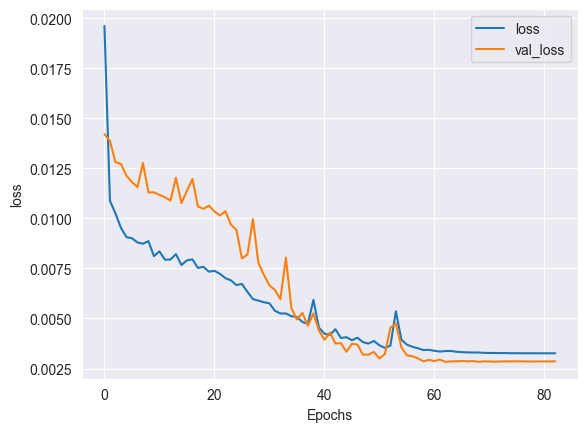

33.0


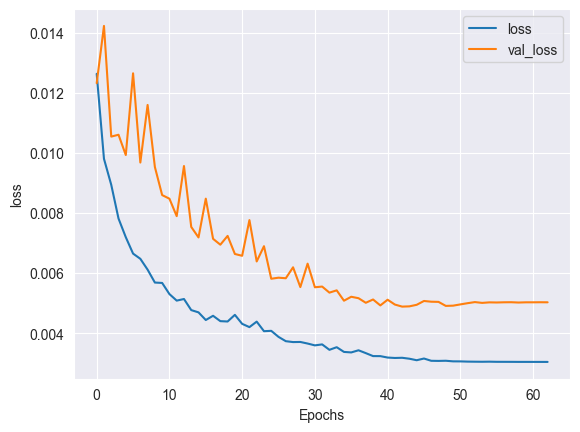

73.0


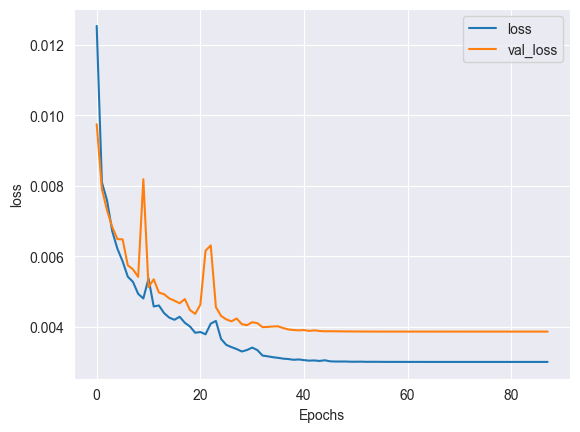

12.0


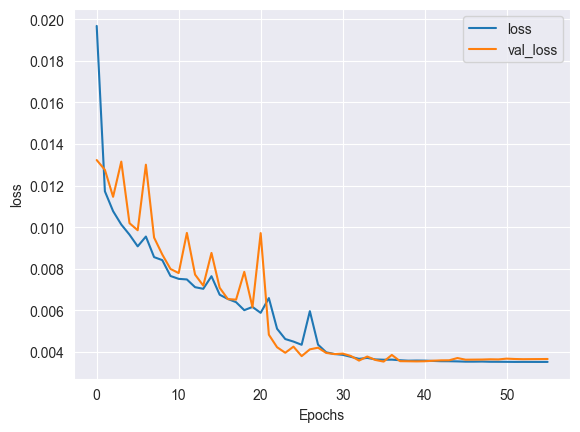

22.0


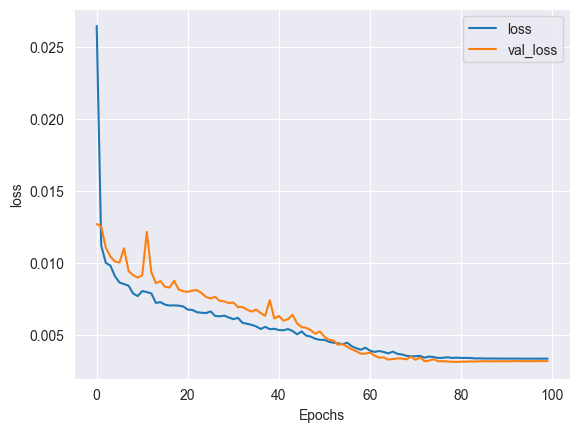

23.0


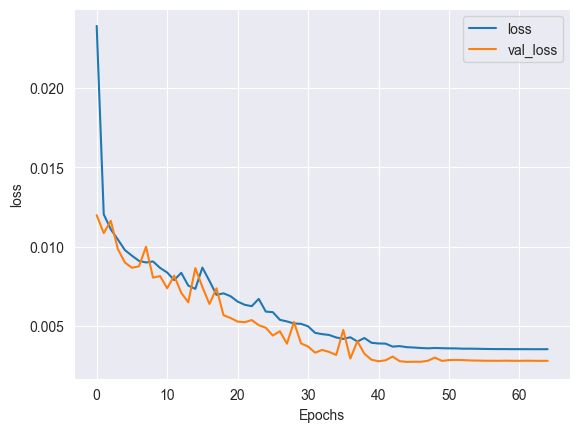

77.0


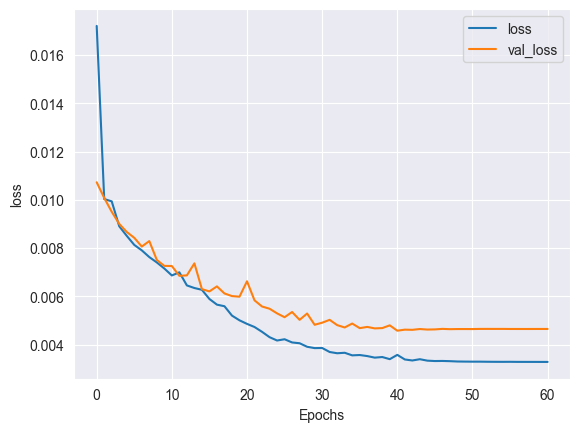

38.0


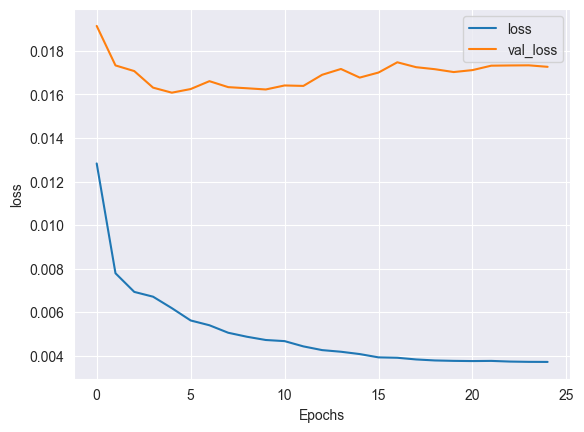

3.0


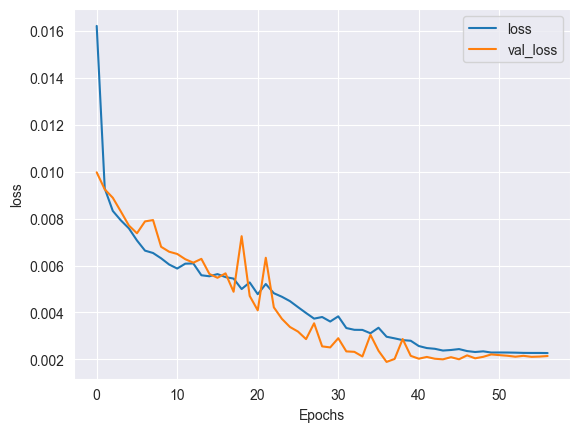

25.0


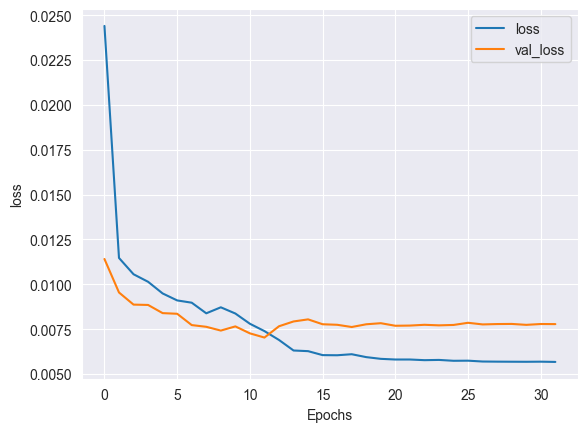

In [33]:
# Helper function to plot loss graphs
def plot_loss_graphs(history, string):
    plt.plot(history.history[string])
    plt.plot(history.history['val_'+string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_'+string])
    plt.show()
    plt.close()

# randomly select 10 categories to plot loss map
Sample_of_loss_graphs=np.random.choice([x for x in history_dict.keys()], 10 ,replace=False,)
for key in Sample_of_loss_graphs:
    print(key)
    plot_loss_graphs(history_dict[key], "loss")

In [34]:
# helper function to reshape dataset to windowed slides for forecast input without shuffling
def model_forecast(model, series, window_size):
    ds = tf.data.Dataset.from_tensor_slices(series)
    ds = ds.window(window_size, shift=1, drop_remainder=True)
    ds = ds.flat_map(lambda w: w.batch(window_size))
    ds = ds.batch(8).prefetch(1)
    forecast = model.predict(ds)
    return forecast

# Return predicted Sales after split_time (validation data)
def predict_results(models_dict,dnn_data_sets, WINDOW_SIZE,SPLIT_TIME,fitted_scalers):
    predictions={}
    total_num_models=len(dnn_data_sets)
    num_model_to_train=total_num_models
    for key,model in ited_dict(models_dict):  # make prediction for each category
        print(f"Number of datasets remained to be predicted {num_model_to_train} out of {total_num_models} remained")
        print(f"Predicting: {key}")
        times, sales = parse_df(dnn_data_sets[key])
        TIME = np.array(times)
        SERIES = np.array(sales)

        dnn_forecast = model_forecast(model,SERIES, WINDOW_SIZE).squeeze()
        dnn_forecast = dnn_forecast[SPLIT_TIME - WINDOW_SIZE:-1]

        predictions_df=pd.DataFrame(index=dnn_data_sets[key][SPLIT_TIME :].index)
        predictions_df["predictions"]=dnn_forecast
        del dnn_forecast
        predictions_df["predictions"]=fitted_scalers[key].inverse_transform(predictions_df[["predictions"]])
        predictions_df["predictions"]=np.where(predictions_df["predictions"]<0,0,predictions_df["predictions"])
        predictions[key]=predictions_df
        num_model_to_train-=1
        IPython.display.clear_output()
        gc.collect()
    print(f"Predictions finnished: {len(predictions)} dataset predicted.")
    return predictions

predictions_dict=predict_results(compiled_models_dict,dnn_data_sets, WINDOW_SIZE,SPLIT_TIME, fitted_scalers)

Predictions finnished: 98 dataset predicted.


47.0


,RMSLE,MAE,RMSE,R2
0,0.242554,394.900452,561.280428,-5.750143


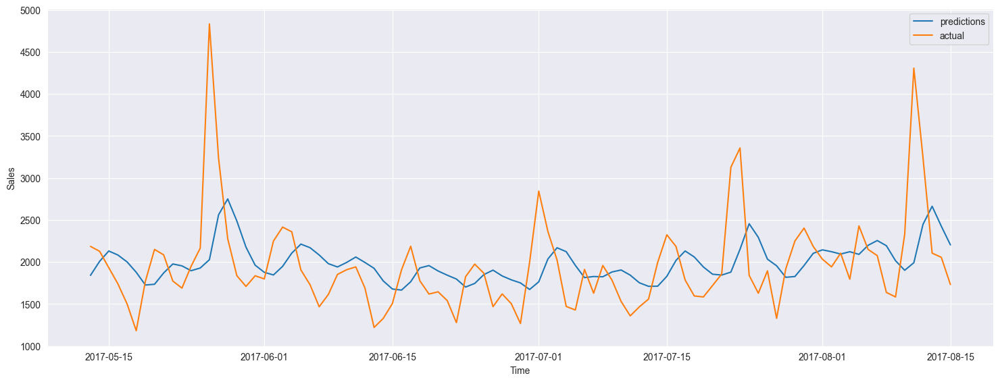

82.0


,RMSLE,MAE,RMSE,R2
0,0.138974,542.905701,729.53911,0.700336


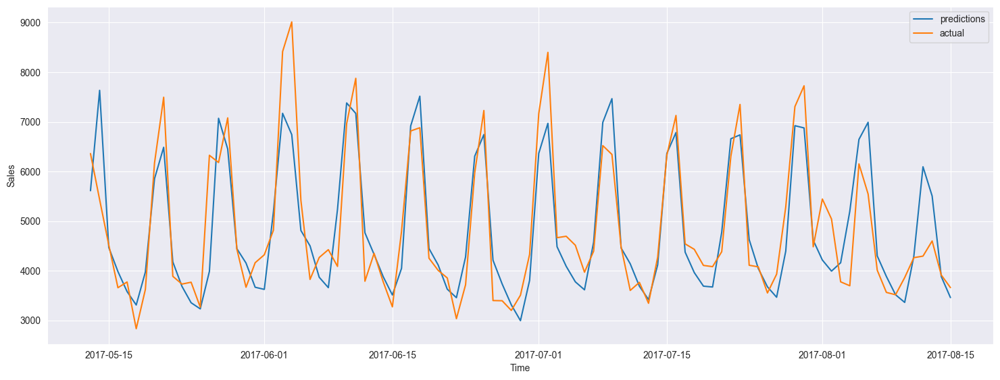

115.0


,RMSLE,MAE,RMSE,R2
0,0.157903,1268.593384,1578.552422,0.395857


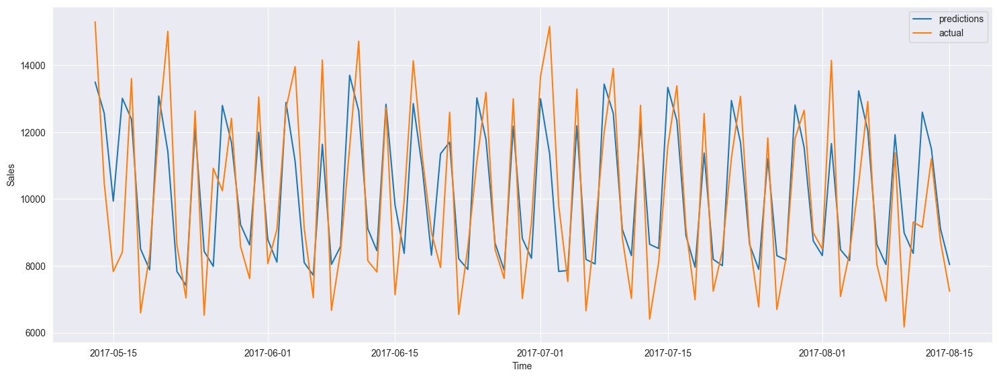

28.0


,RMSLE,MAE,RMSE,R2
0,0.195546,178.063965,215.829785,-0.240034


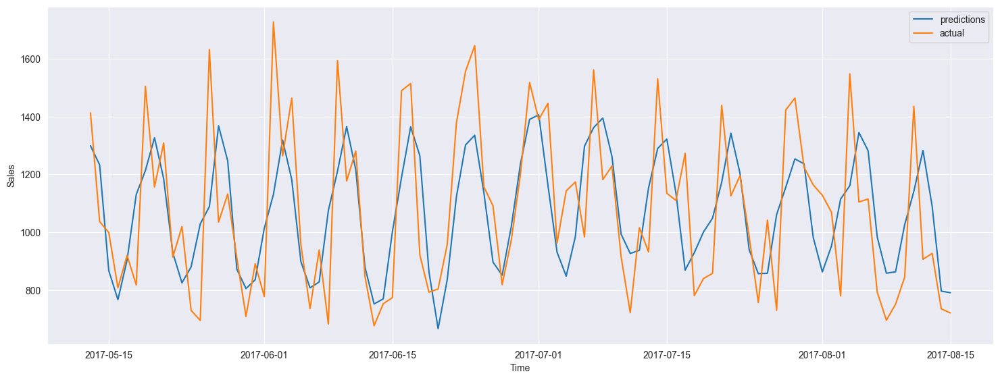

59.0


,RMSLE,MAE,RMSE,R2
0,0.195336,393.449554,524.899514,-0.457949


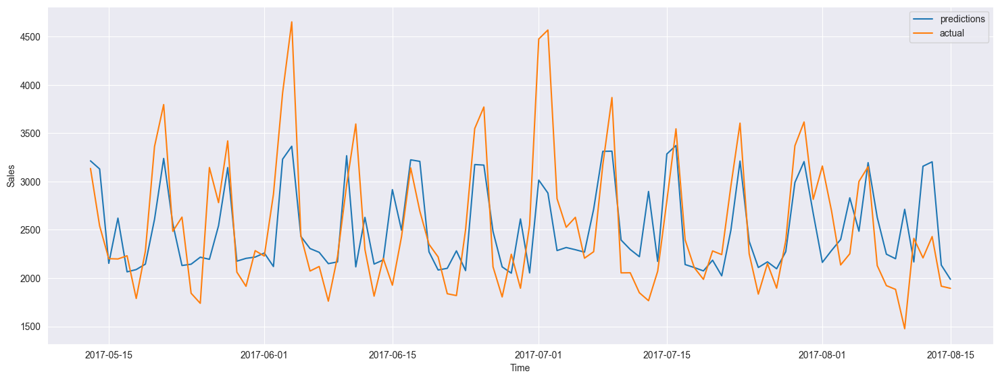

16.0


,RMSLE,MAE,RMSE,R2
0,0.194887,129.80751,166.801757,-0.178047


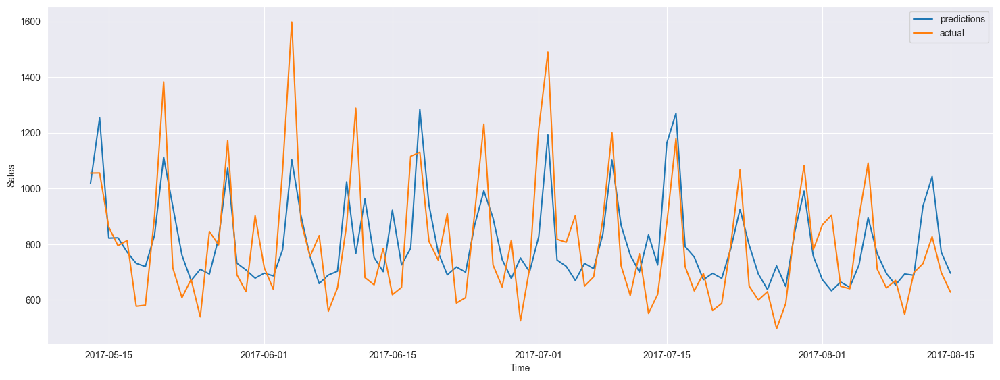

23.0


,RMSLE,MAE,RMSE,R2
0,0.122391,93.747299,126.6713,0.423237


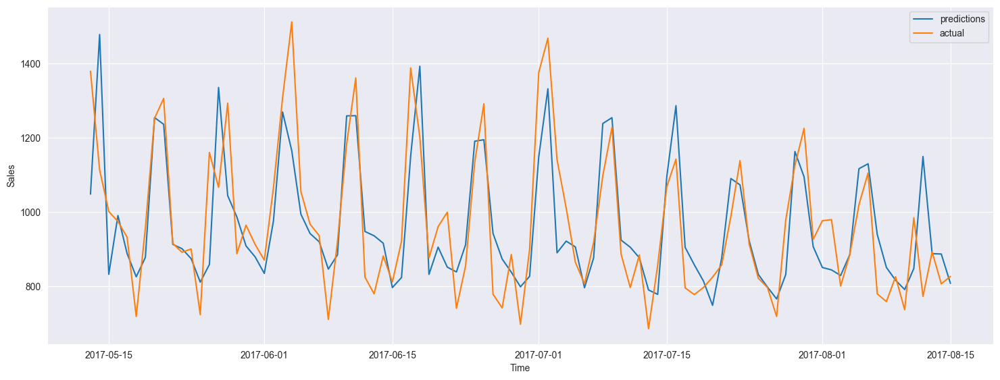

68.0


,RMSLE,MAE,RMSE,R2
0,0.201505,420.215637,561.828516,-1.056071


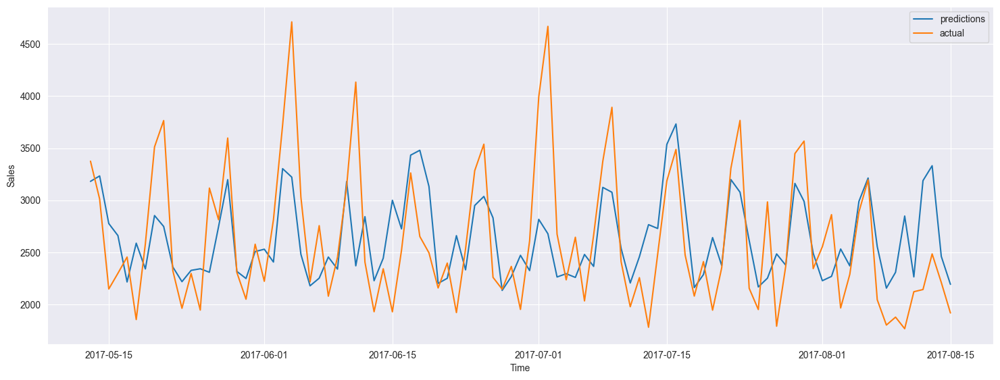

58.0


,RMSLE,MAE,RMSE,R2
0,0.257872,747.275269,971.228796,-1.110611


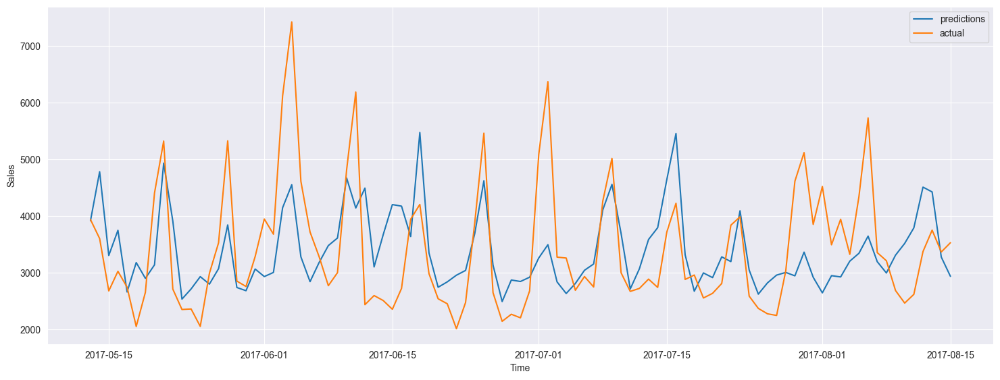

2.0


,RMSLE,MAE,RMSE,R2
0,0.120387,6.496504,8.16514,0.407599


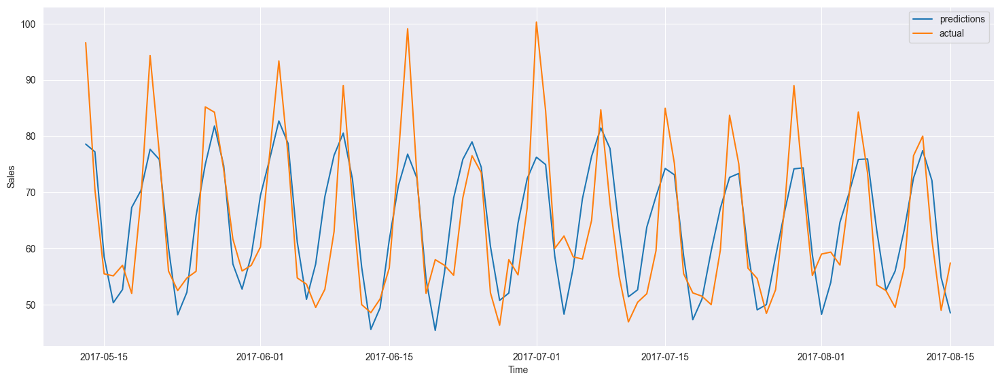

In [35]:
#helper function to plot time series actual vs time series predicted
def plot_series_multi(time1, series1,series2,label1, label2, format1="--",format2="-", start=0, end=None ):
    fig = plt.figure(figsize=(14,5))
    ax = fig.add_axes([1, 1, 1, 1])
    ax.plot(time1[start:end], series1[start:end])
    ax.plot(time1[start:end], series2[start:end])
    ax.legend(labels = (label1, label2))
    plt.xlabel("Time")
    plt.ylabel("Sales")
    plt.grid(True)
    plt.show()
    plt.close()

# printing out metrics and actual vs predicted time series graphs for a subsample of predictions for sub-grouped validation datasets
Sample_of_actual_predict_graphs=np.random.choice([x for x in predictions_dict.keys()], 10 ,replace=False,)
for key in Sample_of_actual_predict_graphs:
    #printing out metrics
    print(key)
    display(calcMetrics(predictions_dict[key].to_numpy(),
                        fitted_scalers[key].inverse_transform(dnn_data_sets[key]["sales"][SPLIT_TIME :].to_numpy().reshape(-1, 1))))

    time1=dnn_data_sets[key].index.values[SPLIT_TIME :]
    series1=predictions_dict[key].to_numpy()
    series2=fitted_scalers[key].inverse_transform(dnn_data_sets[key]["sales"][SPLIT_TIME :].to_numpy().reshape(-1, 1))
    # plotting the graph
    plot_series_multi(time1, series1,series2,"predictions","actual", format1="--",format2="-", start=0, end=None, )

In [36]:
# helper function for mapping predictions from sub-grouped datasets to ungrouped full dataset
def aggragate_predictions(df_valid,predictions_dict):
    df_preds = pd.DataFrame(columns=['predictions'], index=df_valid.index.copy())
    for key,df in ited_dict(predictions_dict):
        for date in df.index:
            df_preds["predictions"]=np.where((df_valid["cat_gen"]==key) & (df_valid["date"]==date),
                                                   df.iloc[df.index.values==date]["predictions"].values[0] ,df_preds["predictions"])
    return df_preds["predictions"].to_numpy()

# helper function for creating ungrouped full validation dataset and parsing it into X and y
def val_dnn_processed(df):
    val_start_index=df.shape[0]-len(df["date"][df["date"] >SPLIT_DATE])
    val=df[val_start_index:]
    y_valid = val.pop("sales")
    X_valid = val
    return X_valid, y_valid
X_valid_dnn, y_valid_dnn = val_dnn_processed(dnn_df_processed_unscaled)

In [37]:
# predicting full-validation datase and calculating metrics
y_pred_dnn=aggragate_predictions(X_valid_dnn,predictions_dict)
calcMetrics(y_pred_dnn,y_valid_dnn)

,RMSLE,MAE,RMSE,R2
0,0.901912,130.944363,456.078552,0.863529


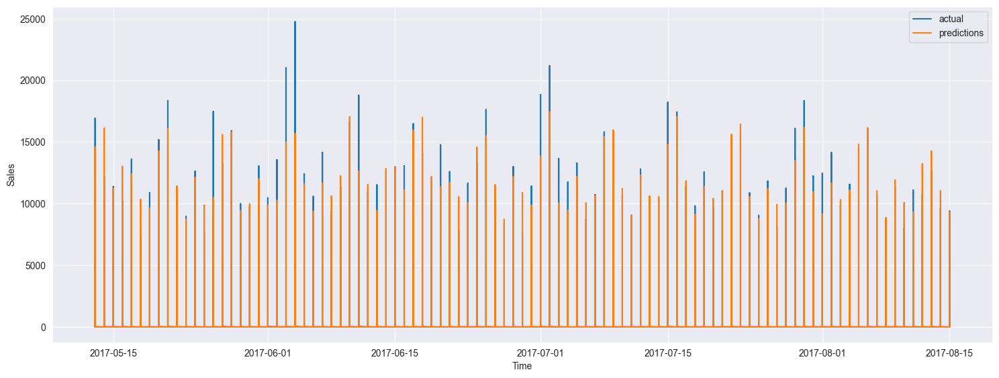

In [38]:
# plotting actual vs predictions for validation dataset
plot_series_multi(dnn_df_processed_unscaled.loc[dnn_df_processed_unscaled["date"]>SPLIT_DATE]["date"].values,
                   dnn_df_processed_unscaled.loc[dnn_df_processed_unscaled["date"]>SPLIT_DATE]["sales"].values, y_pred_dnn,
                  "actual","predictions",format1='r^',format2="b^", start=0, end=None )